In [2]:
import pandas as pd
import numpy as np
import datetime
import math
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from pandas_profiling import ProfileReport
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from os.path import join
import phik
import sqlite3
import os

from sklearn.impute import KNNImputer
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import IsolationForest
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth
from sklearn.neighbors import NearestNeighbors
from sklearn.datasets import make_classification
from sklearn.manifold import TSNE


import warnings
warnings.filterwarnings('ignore')
sns.set()



# IMPORTING DF

In [3]:
df= pd.read_excel(r'WonderfulWinesoftheWorld.xlsx')
df

,Custid,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,...,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend
0,1001.0,789.000,68.0000,16.0000,90782.000,0.0000,0.0000,29.0000,66.0000,1402.0000,...,4.0000,0,1,0,0,0,1,0,0,0
1,1002.0,623.000,78.0000,20.0000,113023.000,0.0000,0.0000,31.0000,6.0000,1537.0000,...,1.0000,0,0,0,0,0,0,0,0,0
2,1003.0,583.000,24.0000,18.0000,28344.000,1.0000,0.0000,4.0000,69.0000,44.0000,...,7.0000,1,0,0,0,0,1,0,1,1
3,1004.0,893.000,59.0000,19.0000,93571.000,0.0000,1.0000,21.0000,10.0000,888.0000,...,5.0000,0,0,0,0,0,0,0,0,0
4,1005.0,1062.000,59.0000,18.0000,91852.000,0.0000,1.0000,25.0000,26.0000,1138.0000,...,6.0000,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9996,10997.0,637.000,76.0000,15.0000,125962.000,0.0000,1.0000,33.0000,75.0000,1668.0000,...,5.0000,0,1,1,0,0,2,0,0,0
9997,10998.0,586.000,69.0000,19.0000,99628.000,0.0000,0.0000,30.0000,98.0000,1469.0000,...,3.0000,0,0,0,0,0,0,0,0,0
9998,10999.0,598.000,65.0000,14.0000,111018.000,1.0000,0.0000,28.0000,4.0000,1350.0000,...,4.0000,0,0,0,0,0,0,0,0,0
9999,11000.0,771.000,20.0000,14.0000,26385.000,1.0000,0.0000,4.0000,24.0000,46.0000,...,5.0000,1,0,0,0,0,1,0,1,0


In [4]:
df= df[:-1]
df.drop(columns= ['Custid'],axis=1,inplace=True)

# INITIAL EXPLORATION OF DATA

### Loading Pandas Profiling

In [5]:
prof = ProfileReport(df)
prof

# Feature Engineering

In [6]:
pd.set_option('display.max_columns', 500)

In [7]:
df['CustomerImportance'] = df['LTV']/df['Dayswus']
df['AvgSpending']= df['Monetary']/df['Freq']

In [8]:
df.describe()

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,CustomerImportance,AvgSpending
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,898.102000,47.927300,16.739100,69904.358000,0.418800,0.469800,14.628100,62.406800,622.555200,209.07120,32.397200,50.382700,7.054500,28.521300,7.069800,6.947400,16.546600,42.376200,5.216600,0.081700,0.069600,0.081700,0.068200,0.01300,0.246000,0.011200,0.101900,0.051100,0.238099,31.942325
std,202.492789,17.302721,1.876375,27612.233311,0.493387,0.499112,11.969073,69.874255,647.135323,291.98604,27.897094,23.453815,7.866544,12.583957,8.015083,7.879546,17.247672,18.522062,2.330457,0.273921,0.254484,0.273921,0.252101,0.11328,0.539178,0.105241,0.302532,0.220213,0.335668,13.711055
min,550.000000,18.000000,12.000000,10000.000000,0.000000,0.000000,1.000000,0.000000,6.000000,-178.00000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,-0.145306,6.000000
25%,723.750000,33.000000,15.000000,47642.000000,0.000000,0.000000,4.000000,26.000000,63.000000,-2.00000,6.000000,32.000000,2.000000,19.000000,2.000000,2.000000,4.000000,28.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,-0.001875,20.000000
50%,894.000000,48.000000,17.000000,70012.000000,0.000000,0.000000,12.000000,52.000000,383.000000,57.00000,25.000000,51.000000,4.000000,28.000000,4.000000,4.000000,10.000000,45.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.063468,31.916667
75%,1074.000000,63.000000,18.000000,92147.000000,1.000000,1.000000,24.000000,78.250000,1077.000000,364.00000,56.000000,69.000000,10.000000,37.000000,10.000000,9.000000,23.000000,57.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.409147,44.875000
max,1250.000000,78.000000,20.000000,140628.000000,1.000000,1.000000,56.000000,549.000000,3052.000000,1791.00000,97.000000,99.000000,75.000000,74.000000,62.000000,77.000000,96.000000,88.000000,10.000000,1.000000,1.000000,1.000000,1.000000,1.00000,3.000000,1.000000,1.000000,1.000000,2.178994,54.500000


In [9]:
df['Teenhome'].value_counts(normalize=True)

0.0    0.5302
1.0    0.4698
Name: Teenhome, dtype: float64

# Data Normalization

In [10]:
features_to_normalize = ['Dayswus', 'Age', 'Edu', 'Income', 'Freq', 'Recency', 'Monetary',
       'LTV', 'Perdeal', 'Dryred', 'Sweetred','Drywh', 'AvgSpending',
       'Sweetwh', 'WebVisit', 'WebPurchase', 'Exotic', 'Dessert', 'Access', 'CustomerImportance']

In [11]:
df_standard = df[features_to_normalize].copy()

In [12]:
scaler = StandardScaler()
scaled_feat = scaler.fit_transform(df_standard)
df_standard[features_to_normalize] = scaled_feat

# CORRELATIONS

In [13]:
df1 = pd.concat([df_standard, df.drop(columns=features_to_normalize)], axis=1)

In [14]:
df1.corr()

,Dayswus,Age,Edu,Income,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,AvgSpending,Sweetwh,WebVisit,WebPurchase,Exotic,Dessert,Access,CustomerImportance,Kidhome,Teenhome,SMRack,LGRack,Humid,Spcork,Bucket,Complain,Mailfriend,Emailfriend
Dayswus,1.000000,-0.019047,-0.001329,-0.024325,0.173071,-0.035765,0.172474,0.098461,0.022797,0.012313,-0.003073,-0.009888,0.188814,-0.007365,0.299574,0.016891,0.023023,-0.010108,-0.009745,-0.070128,0.005195,0.014498,0.001840,-0.003243,-0.018352,-0.006333,0.000827,0.012542,0.008310,0.019985
Age,-0.019047,1.000000,0.207550,0.933583,0.833219,-0.175287,0.814025,0.761844,-0.753151,0.249547,-0.257757,0.028340,0.858695,-0.261471,-0.692475,-0.785863,-0.508769,-0.264996,0.277369,0.761816,-0.610766,0.014552,-0.048756,0.190732,0.382950,0.305612,0.083601,-0.006143,-0.147435,-0.219083
Edu,-0.001329,0.207550,1.000000,0.195853,0.124441,-0.045245,0.116110,0.096610,-0.122083,0.498659,-0.453752,-0.073393,0.163096,-0.454654,-0.081418,-0.102140,-0.382783,-0.452979,0.041401,0.092940,-0.076414,0.102913,0.004311,0.030701,0.039141,0.034659,0.023016,0.001125,-0.042132,-0.046636
Income,-0.024325,0.933583,0.195853,1.000000,0.867487,-0.179506,0.849749,0.788359,-0.783845,0.230303,-0.239146,0.027689,0.898559,-0.242582,-0.650735,-0.734439,-0.487897,-0.244172,0.338644,0.789526,-0.568870,0.009384,-0.016814,0.219635,0.435054,0.329437,0.107088,-0.000161,-0.145464,-0.209531
Freq,0.173071,0.833219,0.124441,0.867487,1.000000,-0.196236,0.993509,0.918741,-0.765027,0.093180,-0.141052,0.101043,0.946417,-0.146355,-0.530790,-0.741564,-0.407574,-0.149187,0.426990,0.875664,-0.579706,-0.194914,0.027967,0.260137,0.512159,0.408623,0.141869,-0.012255,-0.113185,-0.172263
Recency,-0.035765,-0.175287,-0.045245,-0.179506,-0.196236,1.000000,-0.160169,-0.120089,0.163629,-0.078360,0.054167,0.036045,-0.200767,0.059966,0.094405,0.137556,0.089080,0.060992,-0.051185,-0.119938,0.129740,-0.027562,-0.003236,-0.047925,-0.046004,-0.041345,-0.016891,0.004793,0.024410,0.043366
Monetary,0.172474,0.814025,0.116110,0.849749,0.993509,-0.160169,1.000000,0.937844,-0.738683,0.061546,-0.124921,0.129743,0.919412,-0.130331,-0.529255,-0.736133,-0.392008,-0.133143,0.442662,0.889474,-0.554966,-0.227321,0.029727,0.258762,0.541473,0.427098,0.144413,-0.013463,-0.109305,-0.164697
LTV,0.098461,0.761844,0.096610,0.788359,0.918741,-0.120089,0.937844,1.000000,-0.719771,-0.012784,-0.073108,0.174884,0.821164,-0.081816,-0.564960,-0.719239,-0.349172,-0.084864,0.423210,0.958233,-0.543319,-0.306285,0.013866,0.226083,0.555827,0.419647,0.128888,-0.013168,-0.103751,-0.150201
Perdeal,0.022797,-0.753151,-0.122083,-0.783845,-0.765027,0.163629,-0.738683,-0.719771,1.000000,-0.087759,0.101784,-0.027691,-0.821570,0.095663,0.579936,0.667116,0.370660,0.106590,-0.263824,-0.715575,0.755852,0.240979,0.011497,-0.187746,-0.321032,-0.260970,-0.085467,0.010169,0.125019,0.174680
Dryred,0.012313,0.249547,0.498659,0.230303,0.093180,-0.078360,0.061546,-0.012784,-0.087759,1.000000,-0.660342,-0.624605,0.204048,-0.657457,0.104606,0.037654,-0.367955,-0.653681,0.190395,-0.018313,-0.135945,0.505404,0.058490,0.241330,0.037864,0.036789,0.131080,-0.005302,-0.040381,-0.081939


interval columns not set, guessing: ['Dayswus', 'Age', 'Edu', 'Income', 'Freq', 'Recency', 'Monetary', 'LTV', 'Perdeal', 'Dryred', 'Sweetred', 'Drywh', 'AvgSpending', 'Sweetwh', 'WebVisit', 'WebPurchase', 'Exotic', 'Dessert', 'Access', 'CustomerImportance']


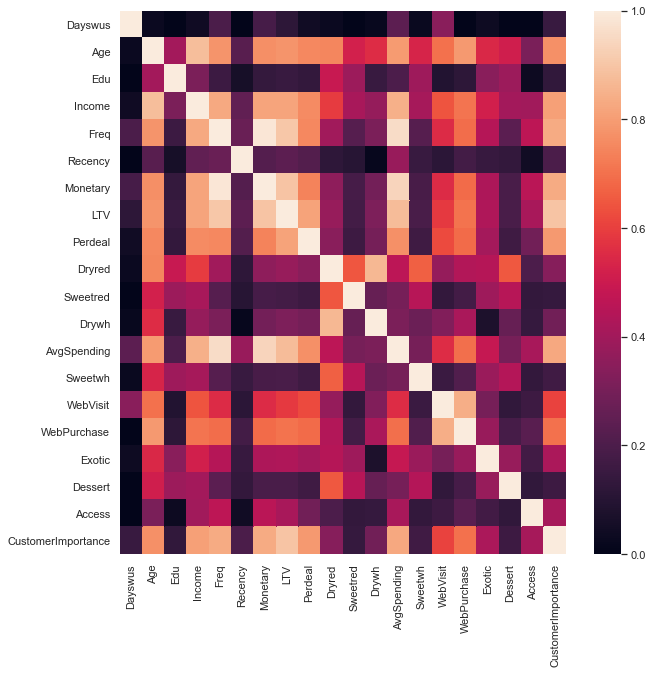

In [15]:
fig, ax = plt.subplots(figsize=(10,10)) # Sample figsize in inches sns.heatmap(df1.iloc[:, 1:6:], annot=True, linewidths=.5, ax=ax)
sns.heatmap(df_standard.phik_matrix())

In [16]:
df1.phik_matrix()

interval columns not set, guessing: ['Dayswus', 'Age', 'Edu', 'Income', 'Freq', 'Recency', 'Monetary', 'LTV', 'Perdeal', 'Dryred', 'Sweetred', 'Drywh', 'AvgSpending', 'Sweetwh', 'WebVisit', 'WebPurchase', 'Exotic', 'Dessert', 'Access', 'CustomerImportance', 'Kidhome', 'Teenhome', 'SMRack', 'LGRack', 'Humid', 'Spcork', 'Bucket', 'Complain', 'Mailfriend', 'Emailfriend']


,Dayswus,Age,Edu,Income,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,AvgSpending,Sweetwh,WebVisit,WebPurchase,Exotic,Dessert,Access,CustomerImportance,Kidhome,Teenhome,SMRack,LGRack,Humid,Spcork,Bucket,Complain,Mailfriend,Emailfriend
Dayswus,1.000000,0.027984,0.000000,0.040131,0.195510,0.000000,0.185206,0.120189,0.044471,0.030963,0.000000,0.019727,0.238685,0.026666,0.346143,0.003872,0.037442,0.000000,0.000000,0.150309,0.029578,0.000000,0.000000,0.005291,0.035202,0.017417,0.000000,0.009763,0.013690,0.000000
Age,0.027984,1.000000,0.403539,0.879961,0.780515,0.230168,0.767723,0.779355,0.751744,0.746522,0.522840,0.555651,0.793394,0.533994,0.700664,0.792301,0.543484,0.511720,0.309963,0.772067,0.840905,0.831914,0.083761,0.299976,0.611956,0.456296,0.144525,0.037943,0.191108,0.300277
Edu,0.000000,0.403539,1.000000,0.314556,0.158314,0.061625,0.136941,0.149210,0.133622,0.489183,0.387264,0.151505,0.202038,0.392330,0.093360,0.120304,0.344950,0.390456,0.032973,0.131401,0.107414,0.142240,0.000000,0.044983,0.047954,0.045160,0.009341,0.019695,0.068926,0.073762
Income,0.040131,0.879961,0.314556,1.000000,0.831957,0.253083,0.818793,0.816730,0.758433,0.593639,0.417101,0.373682,0.846557,0.412372,0.642579,0.707332,0.515979,0.404605,0.398587,0.805692,0.772525,0.639079,0.061737,0.299512,0.756375,0.507919,0.168954,0.011431,0.196906,0.283493
Freq,0.195510,0.780515,0.158314,0.831957,1.000000,0.271648,0.987084,0.904663,0.750721,0.399632,0.224107,0.312787,0.957805,0.225945,0.553872,0.695306,0.448944,0.235195,0.467582,0.835630,0.783121,0.492862,0.078159,0.354676,0.779662,0.602823,0.233884,0.000000,0.158812,0.239820
Recency,0.000000,0.230168,0.061625,0.253083,0.271648,1.000000,0.220268,0.242107,0.218623,0.121934,0.103933,0.018601,0.380168,0.149147,0.113505,0.179502,0.144659,0.136481,0.045146,0.196384,0.200251,0.033633,0.000000,0.065707,0.076675,0.064056,0.000000,0.027926,0.061855,0.075887
Monetary,0.185206,0.767723,0.136941,0.818793,0.987084,0.220268,1.000000,0.898369,0.738437,0.357679,0.184219,0.296285,0.940080,0.190747,0.554553,0.690164,0.429165,0.192078,0.458400,0.835793,0.762646,0.470963,0.064953,0.350071,0.780329,0.600313,0.220839,0.000000,0.142323,0.229272
LTV,0.120189,0.779355,0.149210,0.816730,0.904663,0.242107,0.898369,1.000000,0.814021,0.378190,0.178772,0.319687,0.876987,0.194550,0.589608,0.704937,0.431126,0.192759,0.417672,0.895167,0.873164,0.502558,0.058781,0.311370,0.741164,0.551038,0.198334,0.000000,0.154358,0.246851
Perdeal,0.044471,0.751744,0.133622,0.758433,0.750721,0.218623,0.738437,0.814021,1.000000,0.344714,0.162746,0.297565,0.772976,0.165567,0.624046,0.690569,0.408382,0.164745,0.289459,0.790684,0.922398,0.575622,0.021037,0.251500,0.541930,0.419607,0.105956,0.029027,0.160409,0.233680
Dryred,0.030963,0.746522,0.489183,0.593639,0.399632,0.121934,0.357679,0.378190,0.344714,1.000000,0.645579,0.863451,0.462557,0.667778,0.371763,0.440555,0.446598,0.648509,0.202807,0.337335,0.221575,0.646079,0.088064,0.370298,0.138486,0.119349,0.243527,0.000000,0.094818,0.167665


# PCA (Principal Component Analyses)

In [17]:
pca = PCA()
pca_feat = pca.fit_transform(df1[features_to_normalize])
pca_feat 

array([[ 3.97346193e+00,  1.23244294e+00, -6.79987985e-02, ...,
        -5.31387581e-02,  3.05191749e-02, -3.33195982e-02],
       [ 5.02867708e+00, -2.46579704e-01, -2.16365602e+00, ...,
         2.81653921e-01, -5.73582602e-02,  1.10906170e-03],
       [-3.75645674e+00,  1.17364152e+00,  1.03884882e-01, ...,
        -2.99689867e-02,  9.02216657e-02,  1.10856906e-03],
       ...,
       [ 4.08348323e+00,  7.52843270e-01, -1.51973815e+00, ...,
         3.00073824e-01, -1.81434566e-02,  6.44269598e-04],
       [ 3.75083418e+00,  1.51734690e+00, -3.98388941e-01, ...,
         2.38990698e-01, -1.45554108e-02,  1.32530154e-03],
       [-4.06600089e+00,  3.99323650e+00,  8.31409258e-01, ...,
        -9.03641698e-02,  6.01760989e-02, -7.38240331e-04]])

In [18]:
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,8.619915,0.000000,0.430953,0.430953
2,3.303785,-5.316130,0.165173,0.596125
3,1.399341,-1.904444,0.069960,0.666085
4,1.149050,-0.250291,0.057447,0.723532
5,1.026253,-0.122796,0.051308,0.774840
6,0.905662,-0.120592,0.045279,0.820118
7,0.615237,-0.290425,0.030759,0.850877
8,0.591757,-0.023480,0.029585,0.880462
9,0.576331,-0.015426,0.028814,0.909276
10,0.533337,-0.042994,0.026664,0.935940


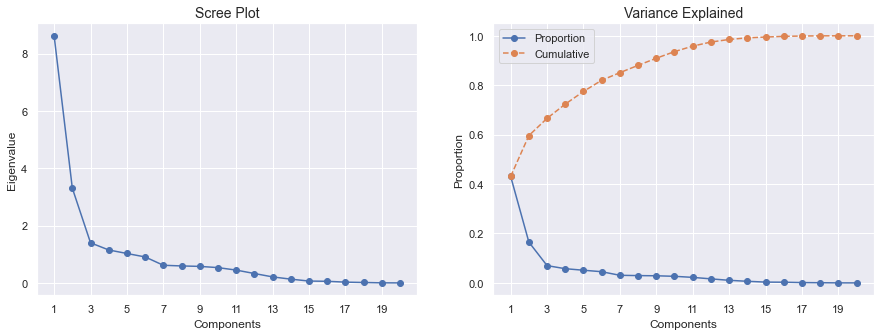

In [19]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [20]:
# Perform PCA again with the number of principal components to retain
pca = PCA(n_components=7)
pca_feat = pca.fit_transform(df1[features_to_normalize])
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=df1.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1,PC2,PC3,PC4,PC5,PC6
0,3.973462,1.232443,-0.067999,-0.344149,1.212108,-0.760028,-0.741502
1,5.028677,-0.246580,-2.163656,-0.442980,-0.351334,-0.618556,-0.050908
2,-3.756457,1.173642,0.103885,1.696136,1.575377,-1.545125,2.225111
3,1.462930,-0.690016,-0.104823,0.310871,-1.174926,0.212924,0.037424
4,1.994424,-0.542736,0.780883,-0.588797,-0.801923,0.179266,0.106892
...,...,...,...,...,...,...,...
9995,0.581730,1.119238,0.841503,-0.602706,0.288765,-0.131750,1.049616
9996,4.254660,-0.154071,0.910928,1.837659,2.049369,-1.001768,-0.185608
9997,4.083483,0.752843,-1.519738,0.176982,0.504737,0.508936,0.304009
9998,3.750834,1.517347,-0.398389,1.090462,-0.307196,-0.440634,-0.763831


In [21]:
# Reassigning df to contain pca variables
df_pca = pd.concat([df1, pca_df], axis=1)
df_pca.head()

,Dayswus,Age,Edu,Income,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,AvgSpending,Sweetwh,WebVisit,WebPurchase,Exotic,Dessert,Access,CustomerImportance,Kidhome,Teenhome,SMRack,LGRack,Humid,Spcork,Bucket,Complain,Mailfriend,Emailfriend,PC0,PC1,PC2,PC3,PC4,PC5,PC6
0,-0.538821,1.160147,-0.393917,0.756139,1.200813,0.051426,1.204514,1.678002,-1.053826,-0.570627,-0.261182,1.230096,1.196357,0.365604,-0.522070,-1.262136,-0.843437,-0.500993,1.398495,1.930077,0.0,0.0,0,1,0,0,0,0,0,0,3.973462,1.232443,-0.067999,-0.344149,1.212108,-0.760028,-0.741502
1,-1.358645,1.738120,1.737959,1.561656,1.367919,-0.807302,1.413136,1.219053,-1.125521,0.196878,-0.769690,0.753274,1.286495,-0.383022,-1.809436,-1.802060,-0.843437,-0.627910,-0.456273,1.992554,0.0,0.0,0,0,0,0,0,0,0,0,5.028677,-0.246580,-2.163656,-0.442980,-0.351334,-0.618556,-0.050908
2,-1.556192,-1.382933,0.672021,-1.505218,-0.888008,0.094363,-0.894070,-0.726342,1.204587,-0.783822,1.518595,-0.359309,-1.527481,-0.757335,0.765296,0.897558,2.693449,2.164268,1.398495,-0.724696,1.0,0.0,1,0,0,0,0,0,1,1,-3.756457,1.173642,0.103885,1.696136,1.575377,-1.545125,2.225111
3,-0.025197,0.639972,1.204990,0.857150,0.532390,-0.750053,0.410205,-0.007094,-0.731195,0.410073,0.374453,-0.756660,0.754421,-0.133480,-0.092948,-0.398259,-0.089675,-0.247159,-0.456273,-0.018758,0.0,1.0,0,0,0,0,0,0,0,0,1.462930,-0.690016,-0.104823,0.310871,-1.174926,0.212924,0.037424
4,0.809442,0.639972,0.672021,0.794892,0.866602,-0.521059,0.796542,0.499805,-0.982130,0.367434,-0.261182,-0.041428,0.990322,-0.383022,0.336174,-0.452251,0.142252,-0.374076,-0.456273,0.286535,0.0,1.0,0,0,0,1,0,0,0,0,1.994424,-0.542736,0.780883,-0.588797,-0.801923,0.179266,0.106892


In [22]:
def _color_red_or_green(val):
    if val < -0.45:
        color = 'background-color: red'
    elif val > 0.45:
        color = 'background-color: green'
    else:
        color = ''
    return color

# Interpreting each Principal Component
loadings = df_pca[features_to_normalize + pca_feat_names].corr().loc[features_to_normalize, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2,PC3,PC4,PC5,PC6
Dayswus,0.032794,-0.026894,0.748719,-0.450967,-0.243531,0.260727,0.024803
Age,0.926695,-0.050514,-0.117245,0.038623,-0.084674,0.080917,0.009108
Edu,0.239524,-0.633956,-0.223551,-0.277124,0.029551,-0.035669,0.053814
Income,0.938459,-0.029406,-0.049857,0.061405,-0.042345,0.044933,0.004312
Freq,0.948351,0.115530,0.219081,-0.044534,0.005945,0.001088,0.001173
Recency,-0.199620,0.048991,-0.104379,-0.098974,0.690673,0.675742,0.004495
Monetary,0.938539,0.143120,0.222249,-0.061390,0.056271,-0.000042,0.001228
LTV,0.902687,0.217150,0.147324,-0.050644,0.126292,-0.024419,0.001921
Perdeal,-0.829133,-0.110464,0.027387,-0.099280,0.098300,-0.087216,0.005759
Dryred,0.205890,-0.926801,0.076944,0.256586,-0.028104,0.087141,0.007035


# Removal of more variables

In [23]:
df1 = df1.drop(['Edu','Freq', 'Monetary', 'Recency', 'Dayswus'], axis=1)

# Define metric and non-metric features

In [24]:
non_metric_features = ['Kidhome', 'Teenhome', 'SMRack', 'LGRack', 'Humid', 'Spcork',
       'Bucket', 'Complain', 'Mailfriend', 'Emailfriend']
metric_features = df1.columns.drop(non_metric_features).to_list()

# CLUSTER K MEANS

In [25]:
dfk = df1.copy()

In [26]:
dfk.drop(['LTV','WebVisit', 'WebPurchase','Dryred', 'Sweetred', 'Drywh','Sweetwh', 'Exotic', 'Dessert', 'Access', 'Kidhome', 'Teenhome', 'SMRack', 'LGRack', 'Humid', 'Spcork',
       'Bucket', 'Complain', 'Mailfriend', 'Emailfriend'], axis=1,inplace=True)

In [27]:
# final cluster solution
number_clusters = 4
kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=30, random_state=42)
km_labels = kmclust.fit_predict(dfk)
km_labels

array([2, 2, 1, ..., 2, 2, 1])

In [28]:
# Characterizing the final clusters with normalized data
df_concat = pd.concat((dfk, pd.Series(km_labels, name='labels')), axis=1)
df_concat['labels'].value_counts()

1    3052
0    2482
3    2400
2    2066
Name: labels, dtype: int64

In [29]:
df_concat_mean=df_concat.copy()
df_concat_mean=df_concat_mean.groupby('labels').mean()
df_concat_mean['labels'] = df_concat_mean.index
df_concat_mean

,Age,Income,Perdeal,AvgSpending,CustomerImportance,labels
labels,,,,,,
0,0.580544,0.547980,-0.686840,0.631938,0.121503,0
1,-1.097828,-1.130475,1.144120,-1.134664,-0.729855,1
2,1.288722,1.323958,-1.077510,1.284766,1.655225,2
3,-0.313683,-0.268822,0.182924,-0.316585,-0.622394,3


(array([0, 1, 2, 3, 4]), <a list of 5 Text major ticklabel objects>)

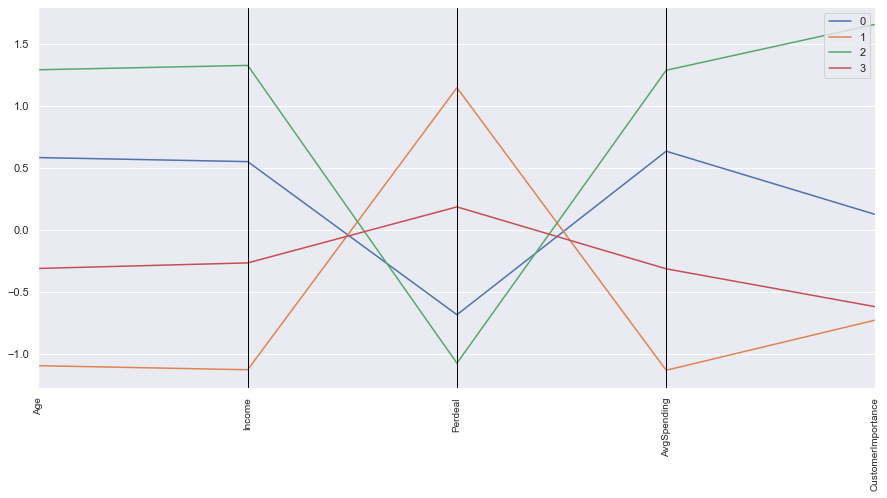

In [30]:
#profiling each cluster with the features used in kmeans clustering
plt.figure(figsize=(15, 7))
pd.plotting.parallel_coordinates(df_concat_mean, class_column = 'labels', color=sns.color_palette())
plt.grid(axis='both',color='w')
plt.xticks(fontsize=10, rotation=90)

In [31]:
df_concat

,Age,Income,Perdeal,AvgSpending,CustomerImportance,labels
0,1.160147,0.756139,-1.053826,1.196357,1.930077,2
1,1.738120,1.561656,-1.125521,1.286495,1.992554,2
2,-1.382933,-1.505218,1.204587,-1.527481,-0.724696,1
3,0.639972,0.857150,-0.731195,0.754421,-0.018758,0
4,0.639972,0.794892,-0.982130,0.990322,0.286535,0
...,...,...,...,...,...,...
9995,-1.151744,-0.565443,-0.910434,0.876285,0.633932,0
9996,1.622525,2.030276,-1.053826,1.356866,1.516913,2
9997,1.217944,1.076520,-1.089673,1.241713,2.432610,2
9998,0.986755,1.489039,-1.017978,1.186836,2.972392,2


In [32]:
dfc_features=['Age','Income','Perdeal','AvgSpending','CustomerImportance']

In [33]:
# This is step can be quite time consuming
two_dim = TSNE(random_state=42).fit_transform(df_concat[dfc_features])

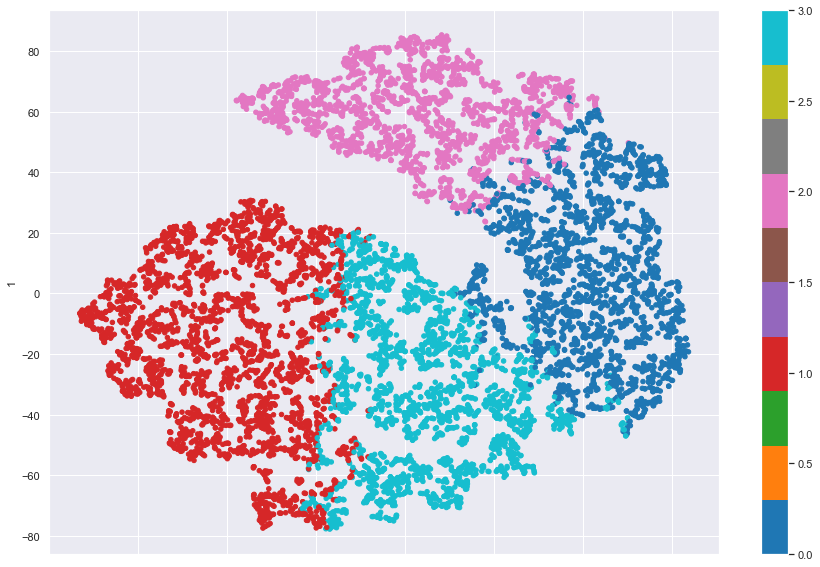

In [34]:
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df_concat['labels'], colormap='tab10', figsize=(15,10))
plt.show()

# QUALITY CHECK

### R2

In [35]:
def get_ss(df):
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst

r2(df_concat[['Age', 'CustomerImportance', 'Income', 'Perdeal', 'AvgSpending', 'labels']],'labels')

0.8568359260240012

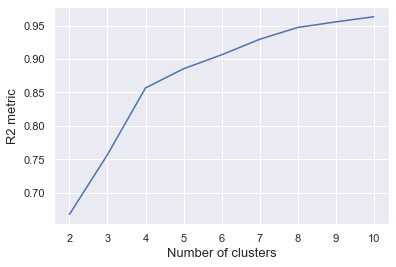

In [36]:
df_r2 = df_concat.copy()
df_r2.drop(['labels'],axis=1,inplace=True)
# Plotting R2 in function of nr of clusters for KMeans
r2_list_kmeans=[]
for i in range(2,11):
    number_clusters = i
    kmclust = KMeans(n_clusters=number_clusters, init='k-means++', n_init=15, random_state=1)
    km_labels1 = kmclust.fit_predict(df_concat)# Characterizing the final clusters
    df_concat_kmeans = pd.concat((df_r2, pd.Series(km_labels1, name='labels')), axis=1)
    r2_list_kmeans.append(r2(df_concat_kmeans[['Age', 'CustomerImportance', 'Income', 'Perdeal', 'AvgSpending', 'labels']],'labels'))

plt.plot(pd.DataFrame(r2_list_kmeans, index=range(2,11), columns=['R2']))
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2 metric", fontsize=13)
plt.show()

### Inertia

In [37]:
range_clusters = range(1, 11)
inertia = []
for n_clus in range_clusters:  # iterate over desired ncluster range
    kmclust = KMeans(n_clusters=n_clus, init='k-means++', n_init=15, random_state=1)
    kmclust.fit(df1[metric_features])
    inertia.append(kmclust.inertia_)

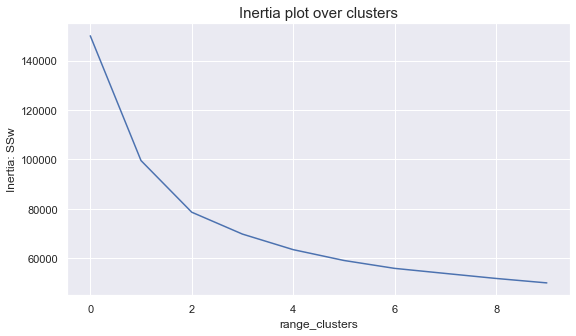

In [38]:
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(inertia)
plt.ylabel("Inertia: SSw")
plt.xlabel("range_clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

### Silhouette

For n_clusters = 2, the average silhouette_score is : 0.2995463975200991
For n_clusters = 3, the average silhouette_score is : 0.258703852891357
For n_clusters = 4, the average silhouette_score is : 0.21388805015894521
For n_clusters = 5, the average silhouette_score is : 0.2008672588372683
For n_clusters = 6, the average silhouette_score is : 0.1866550632738277
For n_clusters = 7, the average silhouette_score is : 0.16425809726958945
For n_clusters = 8, the average silhouette_score is : 0.16447520589810813
For n_clusters = 9, the average silhouette_score is : 0.15724011586354905
For n_clusters = 10, the average silhouette_score is : 0.15430287476800578


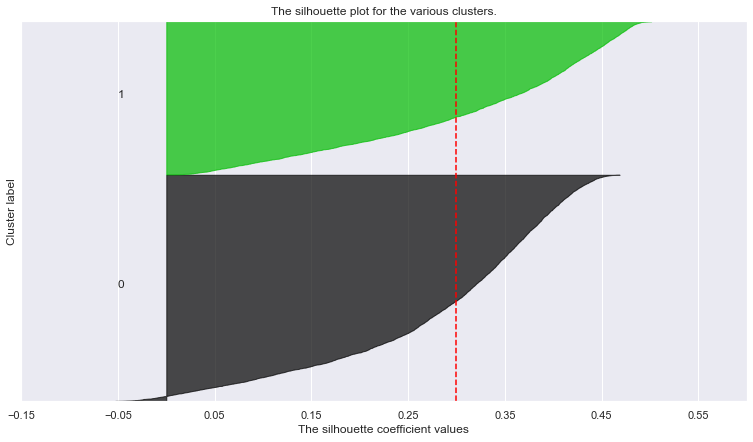

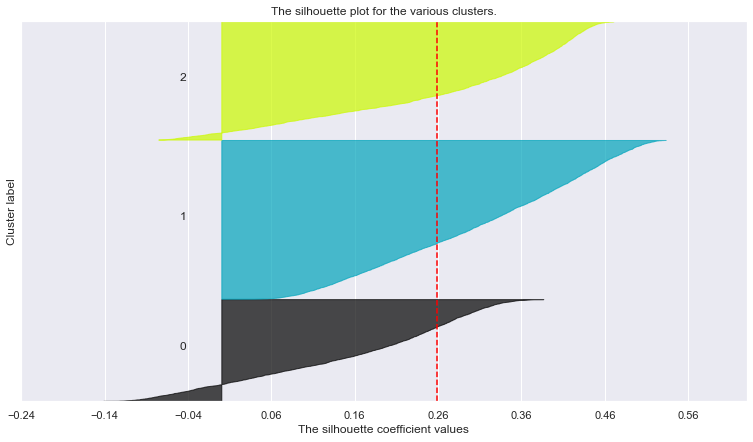

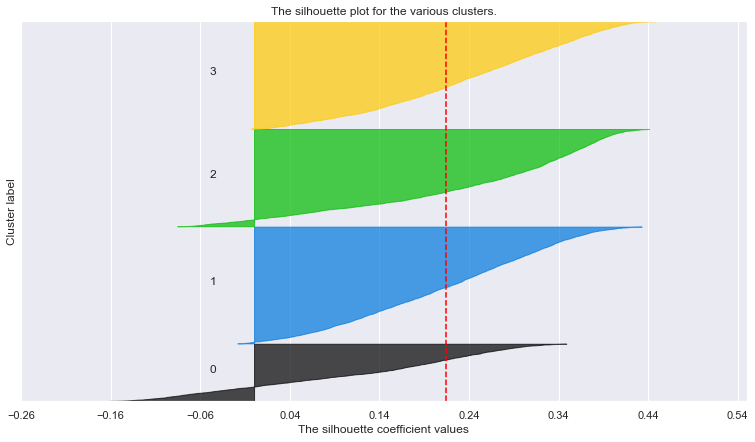

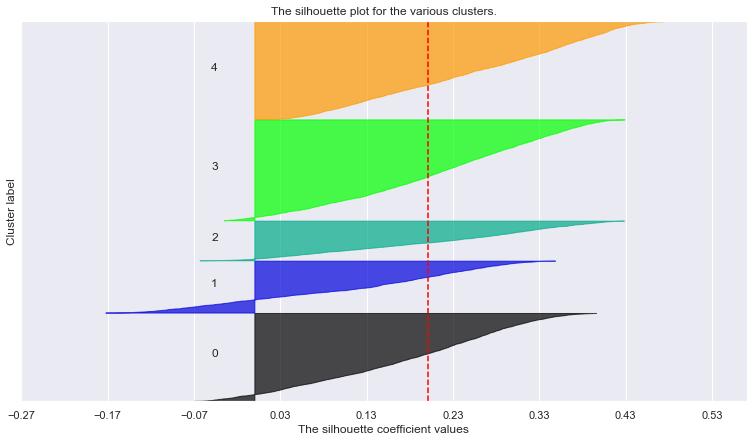

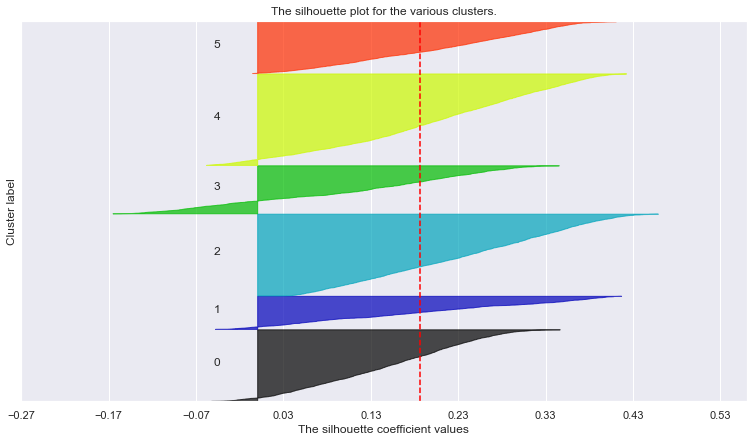

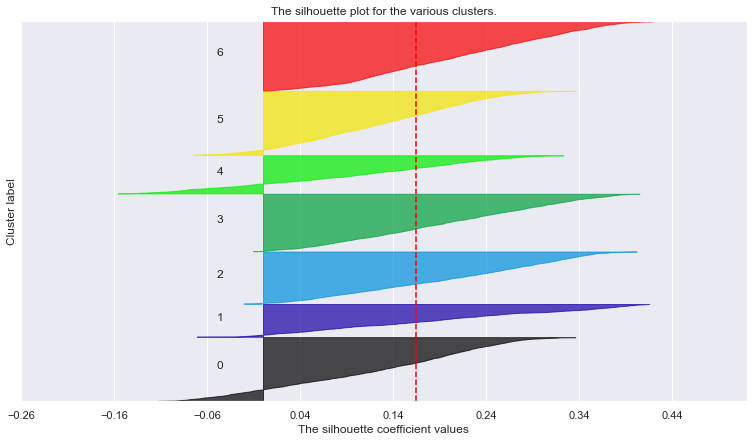

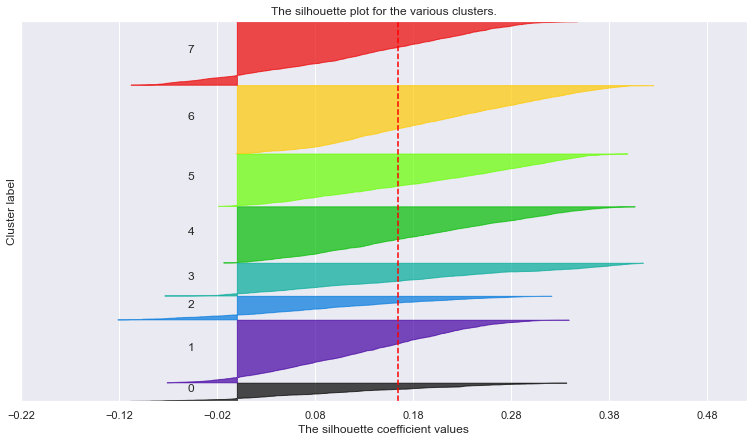

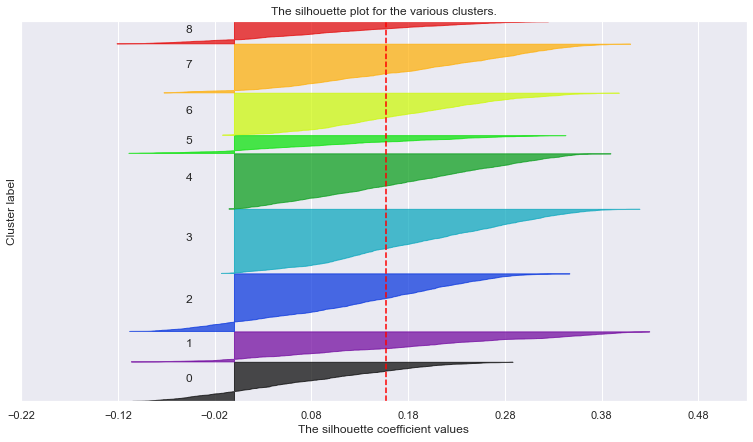

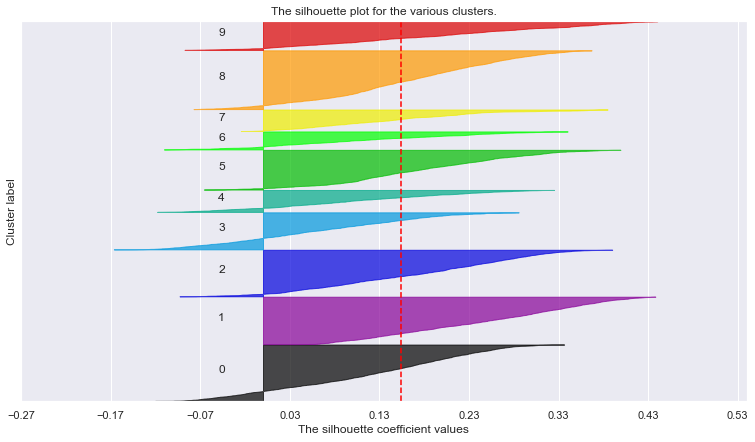

In [39]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(df1[metric_features])

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(df1[metric_features], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df1[metric_features], cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(df1[metric_features]) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

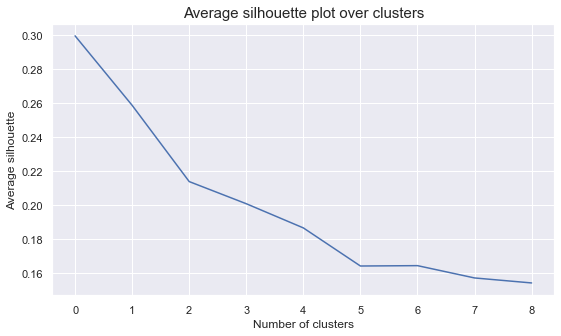

In [40]:
# The average silhouette plot
plt.figure(figsize=(9,5))
plt.plot(avg_silhouette)
ax.set_xlim(1, 24)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

### kelbow_visualizer

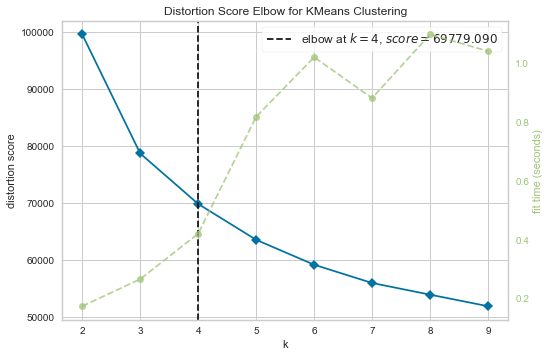

KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x000001EE9E49A1F0>,
                 estimator=KMeans(n_clusters=9, random_state=4), k=None)

In [41]:
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.datasets.loaders import load_nfl

X, y = load_nfl()

# Use the quick method and immediately show the figure
kelbow_visualizer(KMeans(random_state=4), df1[metric_features], k=(2,10))

# Merging Clustered DF with the rest

In [42]:
df2 = df1.drop(['Age','Income','Perdeal','AvgSpending','CustomerImportance', 'SMRack','LGRack','Humid','Spcork','Bucket','Complain','Mailfriend','Emailfriend'],axis=1)

In [43]:
final = pd.concat([df_concat, df2] , axis=1)
final=final.groupby('labels').mean()
final['labels'] = final.index
final

,Age,Income,Perdeal,AvgSpending,CustomerImportance,LTV,Dryred,Sweetred,Drywh,Sweetwh,WebVisit,WebPurchase,Exotic,Dessert,Access,Kidhome,Teenhome,labels
labels,,,,,,,,,,,,,,,,,,
0,0.580544,0.547980,-0.686840,0.631938,0.121503,0.152444,0.399577,-0.184865,-0.373109,-0.203758,-0.245267,-0.349291,-0.344332,-0.203029,-0.054232,0.107977,0.686946,0
1,-1.097828,-1.130475,1.144120,-1.134664,-0.729855,-0.737634,-0.535196,0.417772,0.214767,0.409961,0.645361,0.800701,0.621799,0.416620,-0.298265,0.856488,0.380079,1
2,1.288722,1.323958,-1.077510,1.284766,1.655225,1.636125,-0.214654,-0.047232,0.502478,-0.052252,-1.103025,-1.273139,-0.545923,-0.061882,0.712608,0.043562,0.105518,2
3,-0.313683,-0.268822,0.182924,-0.316585,-0.622394,-0.628059,0.452144,-0.299426,-0.319805,-0.265633,0.382484,0.438961,0.035324,-0.266566,-0.178058,0.506667,0.672917,3


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 <a list of 17 Text major ticklabel objects>)

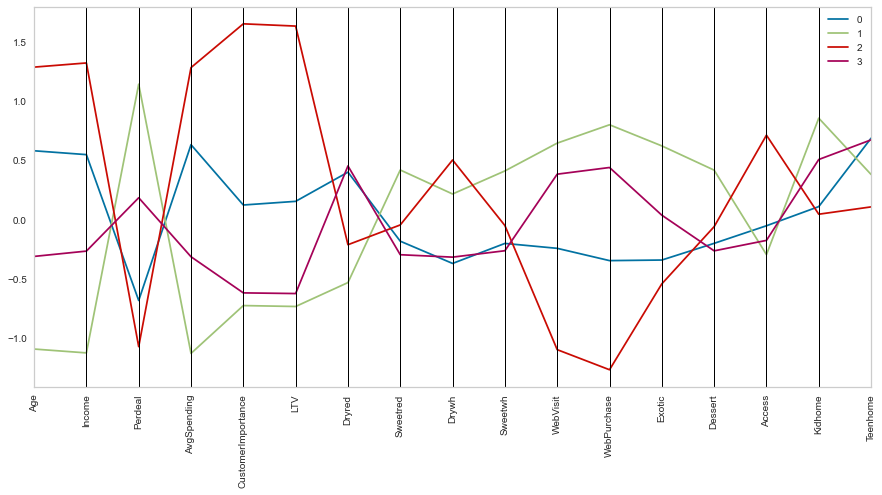

In [44]:
#profiling each cluster with all the features 
plt.figure(figsize=(15, 7))
pd.plotting.parallel_coordinates(final, class_column = 'labels', color=sns.color_palette())
plt.grid(axis='both',color='w')
plt.xticks(fontsize=10, rotation=90)

# Assign labels to raw data

In [45]:
df_raw =df.copy()
df_raw

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,CustomerImportance,AvgSpending
0,789.0,68.0,16.0,90782.0,0.0,0.0,29.0,66.0,1402.0,699.0,3.0,37.0,5.0,44.0,10.0,3.0,2.0,19.0,4.0,0,1,0,0,0,1,0,0,0,0.885932,48.344828
1,623.0,78.0,20.0,113023.0,0.0,0.0,31.0,6.0,1537.0,565.0,1.0,55.0,1.0,38.0,4.0,2.0,2.0,9.0,1.0,0,0,0,0,0,0,0,0,0,0.906902,49.580645
2,583.0,24.0,18.0,28344.0,1.0,0.0,4.0,69.0,44.0,-3.0,66.0,32.0,19.0,24.0,1.0,24.0,63.0,59.0,7.0,1,0,0,0,0,1,0,1,1,-0.005146,11.000000
3,893.0,59.0,19.0,93571.0,0.0,1.0,21.0,10.0,888.0,207.0,12.0,60.0,10.0,19.0,6.0,5.0,15.0,35.0,5.0,0,0,0,0,0,0,0,0,0,0.231803,42.285714
4,1062.0,59.0,18.0,91852.0,0.0,1.0,25.0,26.0,1138.0,355.0,5.0,59.0,5.0,28.0,4.0,4.0,19.0,34.0,6.0,0,0,0,1,0,0,0,0,0,0.334275,45.520000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,967.0,28.0,17.0,54292.0,0.0,0.0,23.0,72.0,1011.0,436.0,7.0,41.0,11.0,36.0,1.0,11.0,42.0,31.0,6.0,0,0,0,1,0,0,0,0,0,0.450879,43.956522
9996,637.0,76.0,15.0,125962.0,0.0,1.0,33.0,75.0,1668.0,476.0,3.0,61.0,2.0,25.0,5.0,6.0,1.0,45.0,5.0,0,1,1,0,0,2,0,0,0,0.747253,50.545455
9997,586.0,69.0,19.0,99628.0,0.0,0.0,30.0,98.0,1469.0,618.0,2.0,46.0,0.0,29.0,11.0,14.0,4.0,18.0,3.0,0,0,0,0,0,0,0,0,0,1.054608,48.966667
9998,598.0,65.0,14.0,111018.0,1.0,0.0,28.0,4.0,1350.0,739.0,4.0,48.0,16.0,27.0,8.0,1.0,8.0,36.0,4.0,0,0,0,0,0,0,0,0,0,1.235786,48.214286


In [46]:
# Characterizing the final clusters with raw data
df_raw_concat = pd.concat((df_raw, pd.Series(km_labels, name='labels')), axis=1)
df_raw_concat=df_raw_concat.groupby('labels').mean()
df_raw_concat['labels'] = df_raw_concat.index
df_raw_concat.drop('labels',axis=1,inplace=True)
df_raw_concat

,Dayswus,Age,Edu,Income,Kidhome,Teenhome,Freq,Recency,Monetary,LTV,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,SMRack,LGRack,Humid,Spcork,Bucket,Access,Complain,Mailfriend,Emailfriend,CustomerImportance,AvgSpending
labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,918.188558,57.971797,16.979049,85034.560435,0.107977,0.686946,19.671233,49.791700,827.772361,253.580580,13.237309,59.753828,5.600322,23.826350,5.436745,5.347703,10.607977,35.906930,4.645044,0.058824,0.109992,0.026591,0.048348,0.021354,0.216761,0.011684,0.068493,0.012087,0.278882,40.606434
1,889.790629,28.932831,16.211337,38690.969201,0.856488,0.380079,3.333224,83.339450,59.639253,-6.296855,64.313237,37.830931,10.340760,31.223788,10.355505,10.230013,27.270642,57.206094,6.720511,0.082569,0.002621,0.000000,0.000983,0.000000,0.085190,0.012779,0.158257,0.113041,-0.006878,16.385668
2,888.219748,70.224589,16.975315,106459.973379,0.043562,0.105518,32.520329,50.950629,1629.147628,686.772991,2.339303,45.348500,6.682962,34.844143,6.651016,6.459826,7.131171,18.796225,2.646176,0.089061,0.148596,0.362052,0.257018,0.030494,0.630203,0.008712,0.054211,0.001936,0.793677,49.556936
3,896.405417,42.500000,16.958750,62481.940833,0.506667,0.672917,8.373750,58.695417,259.659583,25.695833,37.500000,60.986667,4.699167,24.497083,4.940833,4.847083,17.155833,50.506250,6.107917,0.097917,0.045000,0.001250,0.011667,0.005833,0.150000,0.010833,0.105833,0.055000,0.029192,27.601829
